In [1]:
using thesis
using StatsPlots
using PRMaps
using PyCall
using Healpix
using Random, Distributions
using LinearAlgebra

import Stripeline as Sl

In [2]:
a = Instrument(name = "cbass", frequency = 5.0, noisePerPixel = 72.0)
b = Instrument(name = "quijote_11", frequency = 11.0, noisePerPixel = 64.0)
c = Instrument(name = "quijote_13", frequency = 13.0, noisePerPixel = 90.0)
d = Instrument(name = "strip", frequency = 43.0, noisePerPixel = 1.8)
instruments = [a,b,c,d]

4-element Vector{Instrument}:
 Instrument("cbass", 5.0, 72.0)
 Instrument("quijote_11", 11.0, 64.0)
 Instrument("quijote_13", 13.0, 90.0)
 Instrument("strip", 43.0, 1.8)

In [3]:
nside = 64
signals = get_foreground_maps(instruments, nside)
nothing

In [4]:
cam_ang = Sl.CameraAngles()
 
setup = PRMaps.Setup(
    sampling_freq_Hz = 50,
    total_time_s = 24. * 3600. * 1.
    )
nothing

In [5]:
observations = get_observations(cam_ang, signals, setup)
nothing

In [6]:
for indx in length(observations)
    add_white_noise!(observations[indx], instruments[indx], setup) 
end
nothing

In [7]:
result = fgbuster_basic_comp_sep(observations, instruments)

Dict{Any, Any} with 18 entries:
  "nit"       => 6
  "x"         => [1.71303, 20.0003, -3.00003]
  "hess_inv"  => [0.437173 -0.00138219 -8.14489e-5; -0.00138219 0.999997 -1.430…
  "chi_dB"    => [[-1.6375e30 -1.6375e30 … -1.6375e30 -1.6375e30; -1.6375e30 -1…
  "nfev"      => 96
  "status"    => 2
  "chi"       => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; -1.6375e30 -1.6…
  "s"         => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; -1.6375e30 -1.6…
  "njev"      => 81
  "mask_good" => Bool[0, 0, 0, 0, 0, 0, 0, 0, 0, 0  …  0, 0, 0, 0, 0, 0, 0, 0, …
  "success"   => false
  "params"    => ["Dust.beta_d", "Dust.temp", "Synchrotron.beta_pl"]
  "fun"       => -6.5763e10
  "Sigma"     => [-1.10233e16 5.33923e18 0.00108057; 5.33923e18 -2.58611e21 -0.…
  "message"   => "Desired error not necessarily achieved due to precision loss."
  "Sigma_inv" => [3.17826 0.00656176 4825.62; 0.00656176 1.35473e-5 9.96288; 48…
  "jac"       => [-0.00296888, -6.12952e-6, -1.46342]
  "invAtNA"   => [0.78

In [8]:
s = result["Sigma"]

3×3 Matrix{Float64}:
 -1.10233e16   5.33923e18   0.00108057
  5.33923e18  -2.58611e21  -0.5625
  0.00141513  -0.724548     5.31857e-8

In [9]:
sampling = get_mv_distribution(result)
nothing

/home/matteo/.julia/packages/PyCall/ygXW2/src/pyeval.jl:40: RuntimeWarning: covariance is not positive-semidefinite.
  o, globals, locals)


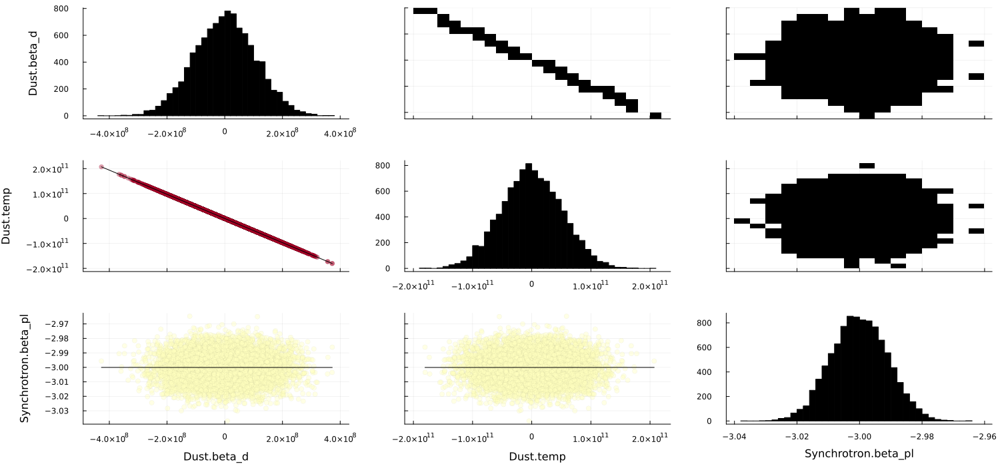

In [10]:
corrplot(sampling, label = result["params"], size = (1500,700), bottom_margin = 6Plots.mm, left_margin = 6Plots.mm)

In [11]:
result["s"][result["s"] .== -1.6375e+30] .= NaN
nothing

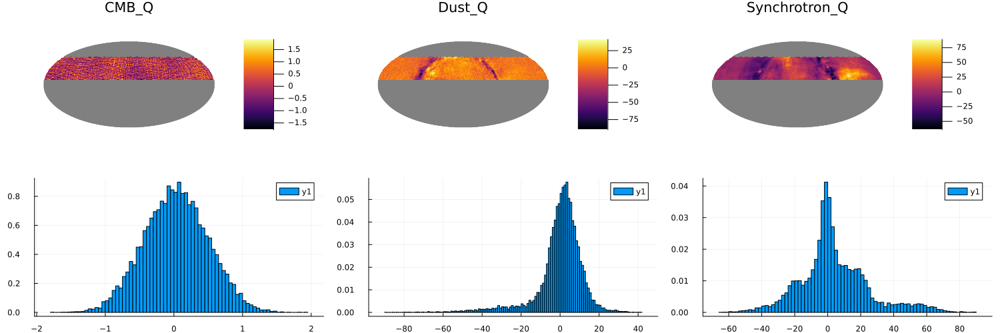

In [12]:
stokes_q = 1

cmb = HealpixMap{Float64, RingOrder}(nside)
dust = HealpixMap{Float64, RingOrder}(nside)
synchrotron = HealpixMap{Float64, RingOrder}(nside)

cmb.pixels = result["s"][1,stokes_q,:]
dust.pixels = result["s"][2,stokes_q,:]
synchrotron.pixels = result["s"][3,stokes_q,:]

p1 = plot(cmb, title = "CMB_Q")
p2 = plot(dust, title = "Dust_Q")
p3 = plot(synchrotron, title = "Synchrotron_Q")

h1 = histogram(cmb[isfinite.(cmb)], normalize = true)
h2 = histogram(dust[isfinite.(dust)], normalize = true)
h3 = histogram(synchrotron[isfinite.(synchrotron)], normalize = true)

plot(p1,p2,p3, h1,h2,h3, layout = (2,3), size = (1500, 500))

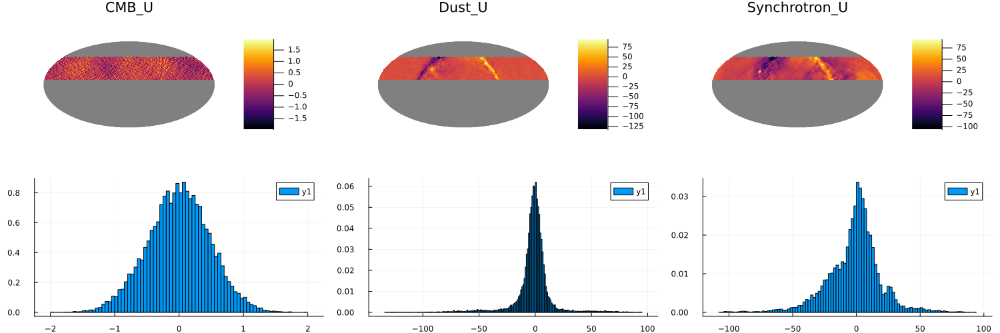

In [13]:
stokes_u = 2

cmb = HealpixMap{Float64, RingOrder}(nside)
dust = HealpixMap{Float64, RingOrder}(nside)
synchrotron = HealpixMap{Float64, RingOrder}(nside)

cmb.pixels = result["s"][1,stokes_u,:]
dust.pixels = result["s"][2,stokes_u,:]
synchrotron.pixels = result["s"][3,stokes_u,:]

p1 = plot(cmb, title = "CMB_U")
p2 = plot(dust, title = "Dust_U")
p3 = plot(synchrotron, title = "Synchrotron_U")

h1 = histogram(cmb[isfinite.(cmb)], normalize = true)
h2 = histogram(dust[isfinite.(dust)], normalize = true)
h3 = histogram(synchrotron[isfinite.(synchrotron)], normalize = true)

plot(p1,p2,p3, h1,h2,h3, layout = (2,3), size = (1500, 500))

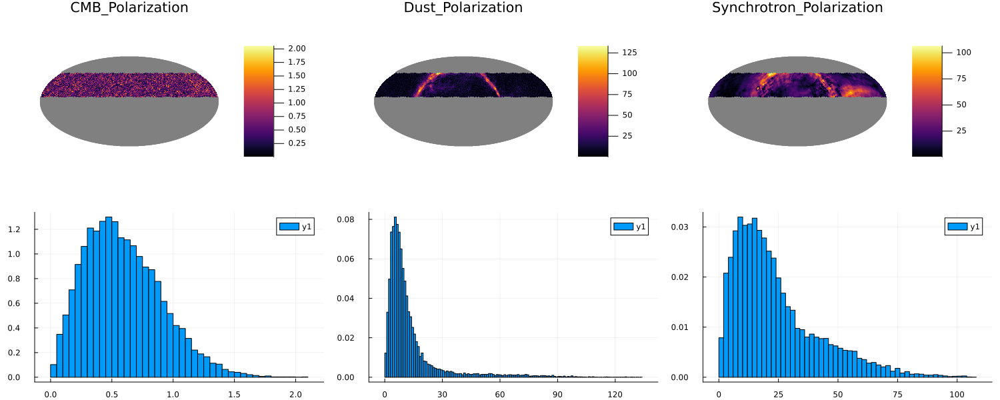

In [26]:
cmb = HealpixMap{Float64, RingOrder}(nside)
dust = HealpixMap{Float64, RingOrder}(nside)
synchrotron = HealpixMap{Float64, RingOrder}(nside)

cmb.pixels = sqrt.(result["s"][1,1,:].^2 .+ result["s"][1,2,:].^2)
dust.pixels = sqrt.(result["s"][2,1,:].^2 .+ result["s"][2,2,:].^2)
synchrotron.pixels = sqrt.(result["s"][3,1,:].^2 .+ result["s"][3,2,:].^2)

p1 = plot(cmb, title = "CMB_Polarization")
p2 = plot(dust, title = "Dust_Polarization")
p3 = plot(synchrotron, title = "Synchrotron_Polarization")

h1 = histogram(cmb[isfinite.(cmb)], normalize = true)
h2 = histogram(dust[isfinite.(dust)], normalize = true)
h3 = histogram(synchrotron[isfinite.(synchrotron)], normalize = true)

plot(p1,p2,p3, h1,h2,h3, layout = (2,3), size = (1500, 600))